In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt

import torch
import torch.nn.functional as F
from torch.utils.data import Dataset, TensorDataset
import gymnasium as gym

from astropy.io import fits
from datetime import datetime, timezone
import json
import fitsio
import pandas as pd
import time
import pickle
import re



%reload_ext autoreload
%autoreload 2

In [2]:
import survey_ops
from survey_ops.utils import units, geometry, interpolate
from survey_ops.src.offline_dataset import OfflineDECamDataset
from survey_ops.src.agents import Agent
from survey_ops.src.algorithms import DDQN, BehaviorCloning
from survey_ops.utils.pytorch_utils import seed_everything


In [3]:
SEED = 10
seed_everything(SEED)
torch.set_default_dtype(torch.float32)
device = torch.device(
    "cuda" if torch.cuda.is_available() else
    "cpu"   
)

In [4]:
from survey_ops.utils.script_utils import get_offline_dataset

# Load and cut data from fits file, save as .json

In [5]:
data_json_fn = '../data/decam-exposures-20251211.json'
data_fits_fn = '../data/decam-exposures-20251211.fits'

try:
    # --- Load json df ---- #
    df = pd.read_json(data_json_fn)
    print('Loaded data from json')
except:
    # --- Load fits ---- #
    print("No .json file found. Instead loading and processing .fits file.")
    d = fitsio.read(data_fits_fn)
    sel = (d['propid'] == '2012B-0001') & (d['exptime'] > 40) & (d['exptime'] < 100) & (~np.isnan(d['teff']))
    selected_d = d[sel]
    column_names = selected_d.dtype.names
    df = pd.DataFrame(selected_d, columns=column_names)
    df['datetime'] = pd.to_datetime(df['datetime'], utc=True)
    
    df.to_json(data_json_fn, indent=2)
    df = pd.read_json(data_json_fn)
    

Loaded data from json


# Instantiate the offline dataset choosing binning method (healpix vs uniform_grid)

In [7]:
binning_method='healpix'
nside=16
bin_space='radec'
specific_years=None
specific_months = None
specific_days=None
specific_years=[2017]
specific_months=[12]
# specific_days=[15]
include_default_features=True
include_bin_features=False
do_z_score_norm=False
do_cyclical_norm=True
do_max_norm=True
do_inverse_airmass=True

In [31]:
dataset = OfflineDECamDataset(
    df, 
    binning_method=binning_method,
    nside=nside,
    bin_space=bin_space,
    specific_years=specific_years,
    specific_months=specific_months,
    specific_days=specific_days,
    include_default_features=include_default_features,
    include_bin_features=include_bin_features,
    do_z_score_norm=do_z_score_norm,
    do_cyclical_norm=do_cyclical_norm,
    do_max_norm=do_max_norm,
    do_inverse_airmass=do_inverse_airmass
)

Calculating sun and moon ra/dec and az/el: 100%|█| 2263/2263 [00:04<00:00, 492.0
Calculating action mask: 100%|██████████████| 2263/2263 [00:28<00:00, 79.82it/s]


In [15]:
dataset.states.shape, dataset.next_states.shape, dataset.actions.shape, dataset.rewards.shape, dataset.dones.shape, dataset.action_masks.shape

(torch.Size([2263, 22]),
 torch.Size([2263, 22]),
 torch.Size([2263]),
 torch.Size([2263]),
 torch.Size([2263]),
 torch.Size([2263, 3072]))

# Visualize dataset in az, el and ra, dec

In [8]:
obj_names, counts = np.unique(dataset._df.object, return_counts=True)

Text(0, 0.5, 'Number of fields')

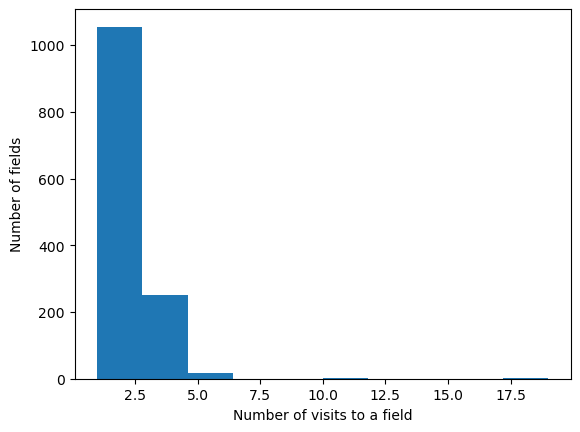

In [9]:
plt.hist(counts)
plt.xlabel('Number of visits to a field')
plt.ylabel('Number of fields')

Text(0.5, 0, 'Number of observations in a night')

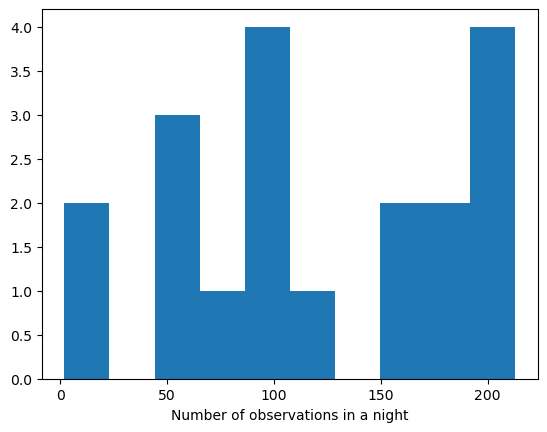

In [10]:
plt.hist(dataset.n_obs_per_night)
plt.xlabel('Number of observations in a night')

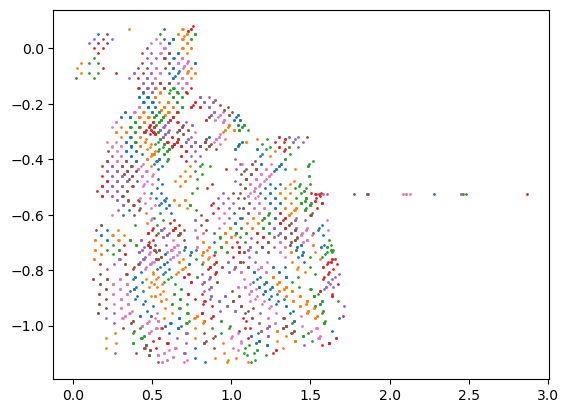

In [11]:
colors = [f'C{i}' for i in range(7)]
for i, (bin_id, g) in enumerate(dataset._df.groupby('bin')):
    plt.scatter(g.ra, g.dec, label=bin_id, color=colors[i%len(colors)], s=1)

# Train

In [12]:
batch_size = 1024
num_workers = 4
pin_memory = True if device == 'cuda' else False
trainloader = dataset.get_dataloader(batch_size, num_workers = num_workers, pin_memory = pin_memory)
dataset_size = np.prod(len(dataset))
batches_per_dataset = dataset_size // batch_size
lr_scheduler = 'cosine_annealing'
lr_scheduler_kwargs = {'T_max': batches_per_dataset, 'eta_min': 1e-6}


In [13]:
"""Algorithm and Train setup"""
exp_name_prefix = 'v1f-environment-testing2'

bc_alg_config = {
    'obs_dim': dataset.obs_dim,
    'num_actions': dataset.num_actions,
    'hidden_dim': 1024,
    'device': device,
    'lr': 3e-3,
    'loss_fxn': None, #torch.nn.cross_entropy,
    'lr_scheduler': 'cosine_annealing',
    'lr_scheduler_kwargs': lr_scheduler_kwargs
}
alg = BehaviorCloning(**bc_alg_config)

# ddqn_alg_config = {
#     'obs_dim': dataset.obs_dim,
#     'num_actions': dataset.num_actions,
#     'hidden_dim': 128,
#     'device': device,
#     'gamma': .95,
#     'tau': 1e-4,
#     'lr': 1e-3,
#     'loss_fxn': None,
#     use_double=True,
# }
# alg = DDQN(**ddqn_alg_config)

fit_config = {
    'num_epochs': 10, #ie, number of iterations through entire dataset
    'batch_size': batch_size,
    # 'learning_start': 
    }

env_name = 'OfflineEnv'

def create_exp_name(alg, env_name, dataset, fit_config, alg_config, prefix=None):
    if prefix is not None:
        exp_name = prefix
    else:
        exp_name = ''
    exp_name += f"{alg.name}"
    exp_name += f"-{env_name}"
    exp_name += f"-n_nights={dataset.n_nights}"
    # config_prefix += f"-use_double={alg_config['use_double']}"
    exp_name += f"-num_epochs={fit_config['num_epochs']}"
    exp_name += f"-batch_size={fit_config['batch_size']}"
    exp_name += f"-lr={alg_config['lr']}"
    return exp_name

exp_name = create_exp_name(alg, env_name, dataset, fit_config, bc_alg_config, prefix=exp_name_prefix)

outdir = f'../results/{exp_name}/'
if not os.path.exists(outdir):
    os.makedirs(outdir)
fig_outdir = outdir + 'figures/'
if not os.path.exists(fig_outdir):
    os.makedirs(fig_outdir)

agent_config = {
    'algorithm': alg,
    'train_outdir': outdir
    }

agent = Agent(**agent_config)

# Train

In [14]:
# circle on gif is a 1.1deg radius --> maybe nside = 16 is enough, (nside=32 is about a 3 deg area)

In [15]:
import time

In [16]:
do_train = False
load_previous = True
    
if os.path.exists(outdir + 'best_weights.pt') and load_previous:
    print('Loading best_weights.pt')
    agent.load(filepath=outdir + 'best_weights.pt')
if do_train:
    start_time = time.time()
    """Train"""
    agent.fit(
        dataloader=trainloader,
        **fit_config
        )
    end_time = time.time()
    train_time = end_time - start_time
    print(f'Total train time = {train_time}s on {device}')

Loading best_weights.pt


In [17]:
with open(outdir + 'train_metrics.pkl', 'rb') as handle:
    train_metrics = pickle.load(handle)

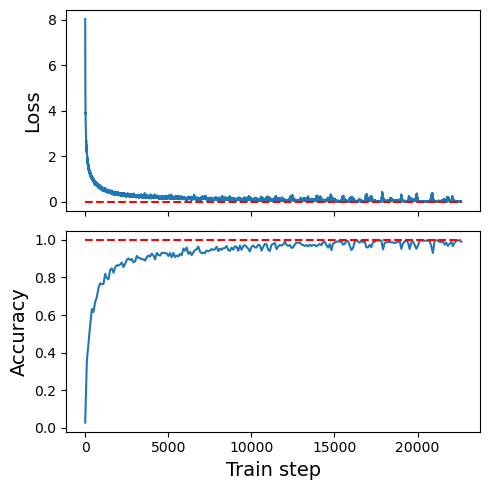

In [18]:
fig, axs = plt.subplots(2, sharex=True, figsize=(5, 5))
axs[0].plot(train_metrics['loss_history'])
axs[0].hlines(y=0, xmin=0, xmax=len(train_metrics['loss_history']), color='red', linestyle='--')
axs[0].set_ylabel('Loss', fontsize=14)
axs[1].plot(np.linspace(0, len(train_metrics['loss_history']), len(train_metrics['test_acc_history'])), train_metrics['test_acc_history'])
axs[1].hlines(y=1, xmin=0, xmax=len(train_metrics['loss_history']), color='red', linestyle='--')
axs[1].set_xlabel('Train step', fontsize=14)
axs[1].set_ylabel('Accuracy', fontsize=14)
axs[1].set_xlabel('Train step', fontsize=14)
fig.tight_layout()
fig.savefig(fig_outdir + 'train_history.png')

# Roll out policy on train dataset

## Using gym.env

In [19]:
test_dataset = OfflineDECamDataset(
    df, 
    binning_method=binning_method,
    nside=nside,
    bin_space=bin_space,
    specific_years=specific_years,
    specific_months=specific_months,
    specific_days=specific_days,
    include_default_features=include_default_features,
    include_bin_features=include_bin_features,
    do_z_score_norm=do_z_score_norm,
    do_cyclical_norm=do_cyclical_norm,
)

Calculating sun and moon ra/dec and az/el: 100%|█| 2263/2263 [00:01<00:00, 1274.
Calculating zenith states: 100%|██████████████| 19/19 [00:00<00:00, 1133.60it/s]


In [20]:
from survey_ops.src.environments import OfflineEnv

In [21]:
gym.register(
    id=f"gymnasium_env/{env_name}",
    entry_point=OfflineEnv,
    #max_episode_steps=1000000,  # Prevent infinite episodes. Here just set to 300 even though episode will terminate when stepping to last element of sequence
)

# for eval step only
env_config = {
    'id': f"gymnasium_env/{env_name}",
    'test_dataset': test_dataset,
    'max_nights': None,
}

env = gym.make(**env_config)

In [22]:
# state, info = env.reset()
# episode_reward = 0
# terminated = False
# truncated = False
# state_list = [state]
# rewards_list = [0]
# actions = []

# i = 0
# while not (terminated or truncated):
#     with torch.no_grad():
#         # if env.unwrapped._night_idx != 0:
#         #     print(env.unwrapped._night_idx)
#         action_mask = info.get('action_mask', None)
#         action = agent.act(state, action_mask, epsilon=None)  # greedy
#         actions.append(action)
#         state, reward, terminated, truncated, info = env.step(action)
#         state_list.append(state)
#         # rewards_list.append(reward)
#         # episode_reward += reward
#         i += 1
#         # if i==1:
#         #     break

## Evaluate agent given environment

In [23]:
from survey_ops.utils import ephemerides

In [33]:
agent.evaluate(env=env, num_episodes=1, field_choice_method='random', eval_outdir=outdir)
with open(outdir + 'eval_metrics.pkl', 'rb') as handle:
    eval_metrics = pickle.load(handle)

100%|█████████████████████████████████████████████| 1/1 [00:02<00:00,  2.71s/it]

terminated at 2600
eval_metrics.pkl saved in ../results/v1f-environment-testing2BehaviorCloning-OfflineEnv-n_nights=19-num_epochs=10-batch_size=1024-lr=0.003/


In [25]:
ep_num = 0

In [26]:
dataset.state_feature_names

['ra_cos',
 'ra_sin',
 'dec',
 'az_cos',
 'az_sin',
 'el',
 'airmass',
 'ha_cos',
 'ha_sin',
 'sun_ra_cos',
 'sun_ra_sin',
 'sun_dec',
 'sun_az_cos',
 'sun_az_sin',
 'sun_el',
 'moon_ra_cos',
 'moon_ra_sin',
 'moon_dec',
 'moon_az_cos',
 'moon_az_sin',
 'moon_el',
 'time_fraction_since_start']

It's not the times

/tmp/ipykernel_24743/1273938169.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig_b, axs_b = plt.subplots(2, figsize=(10,7), sharex=True)


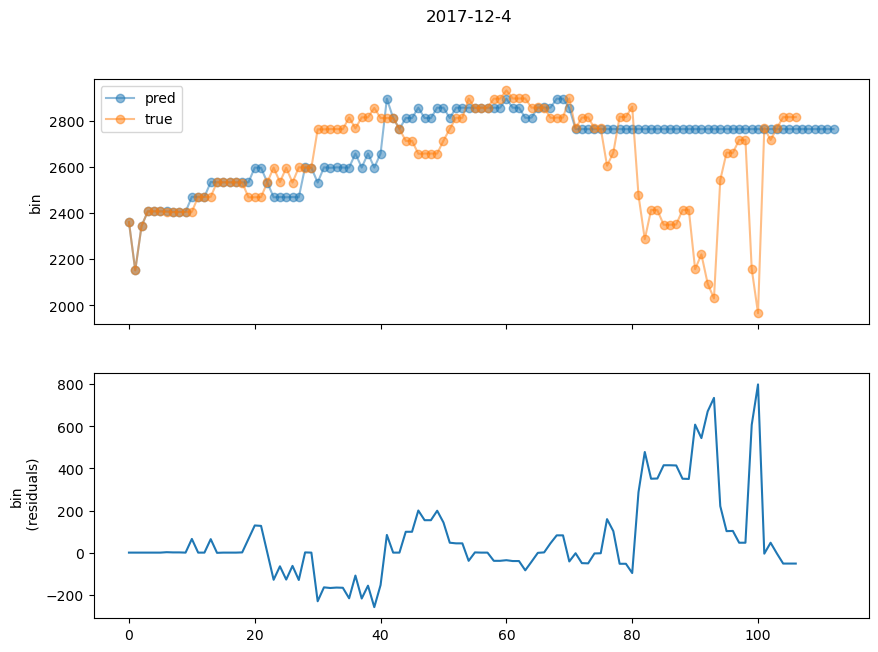

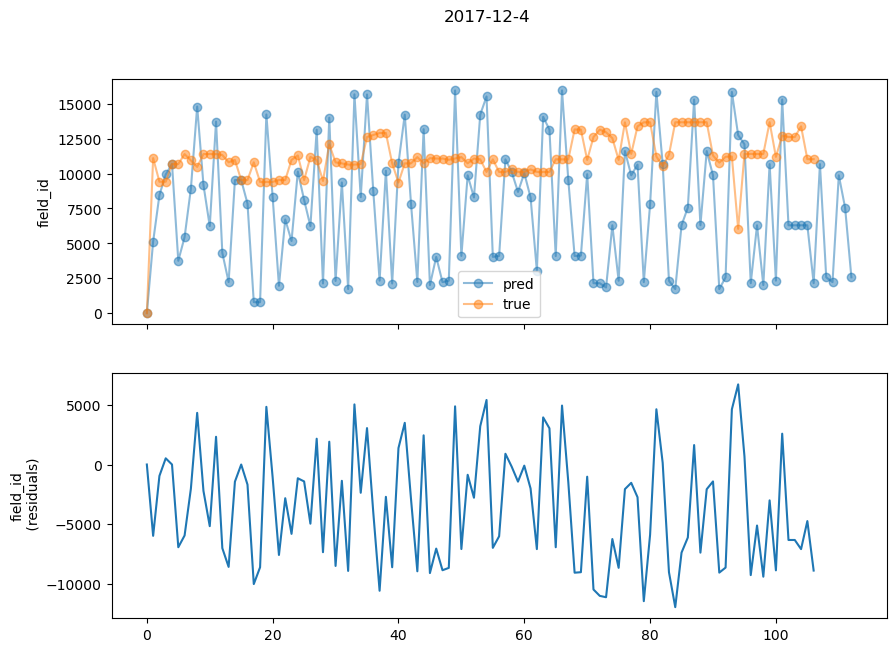

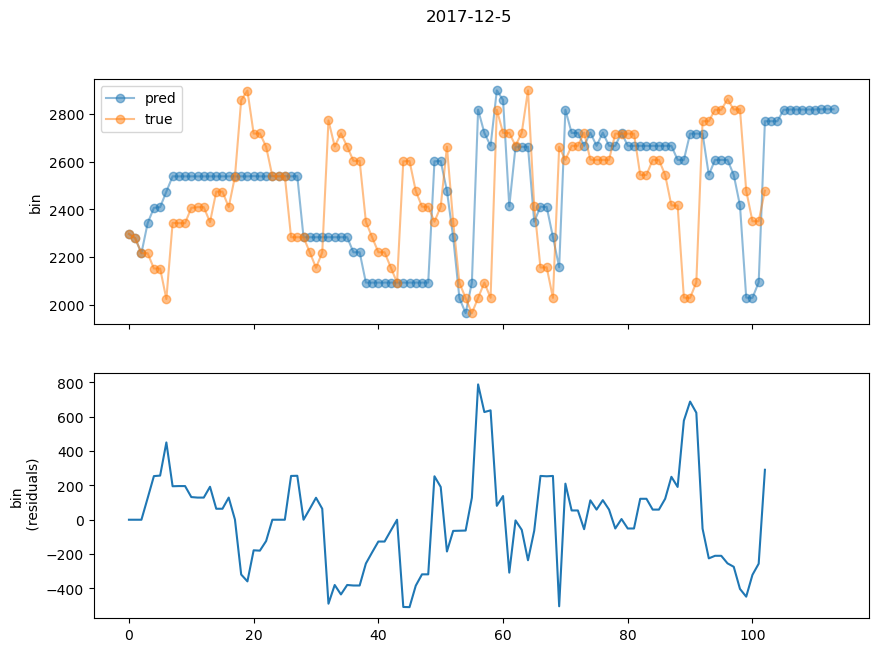

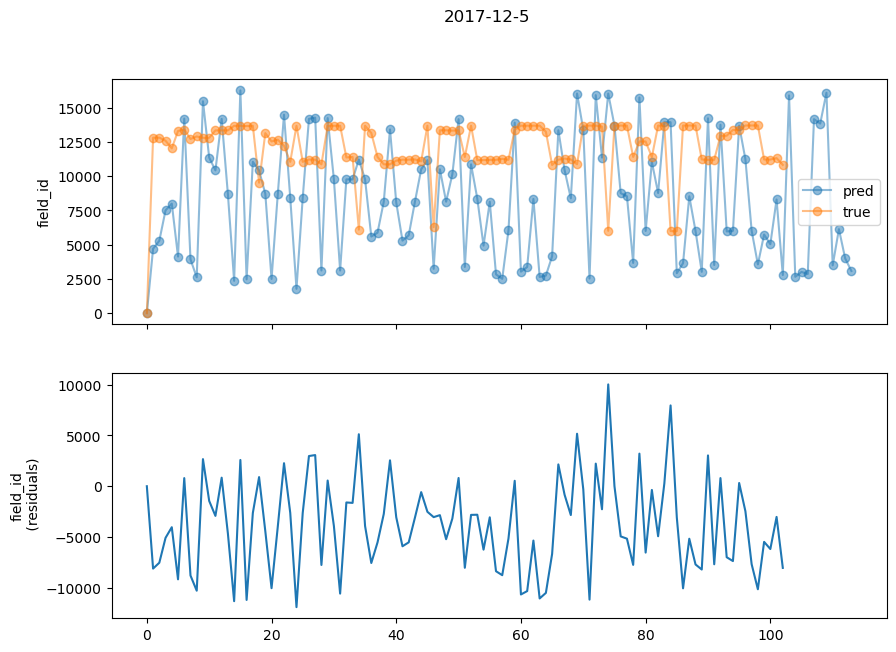

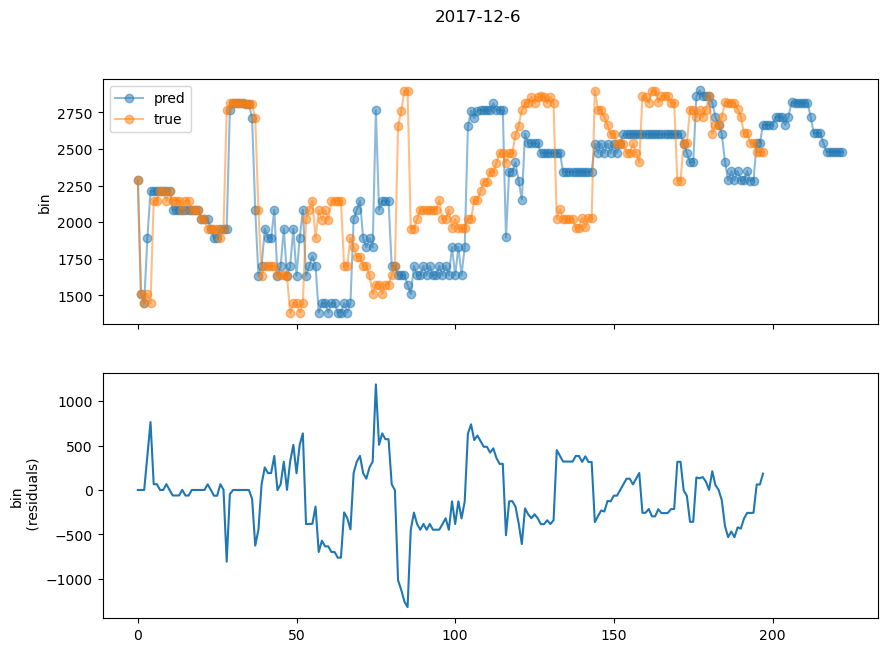

...

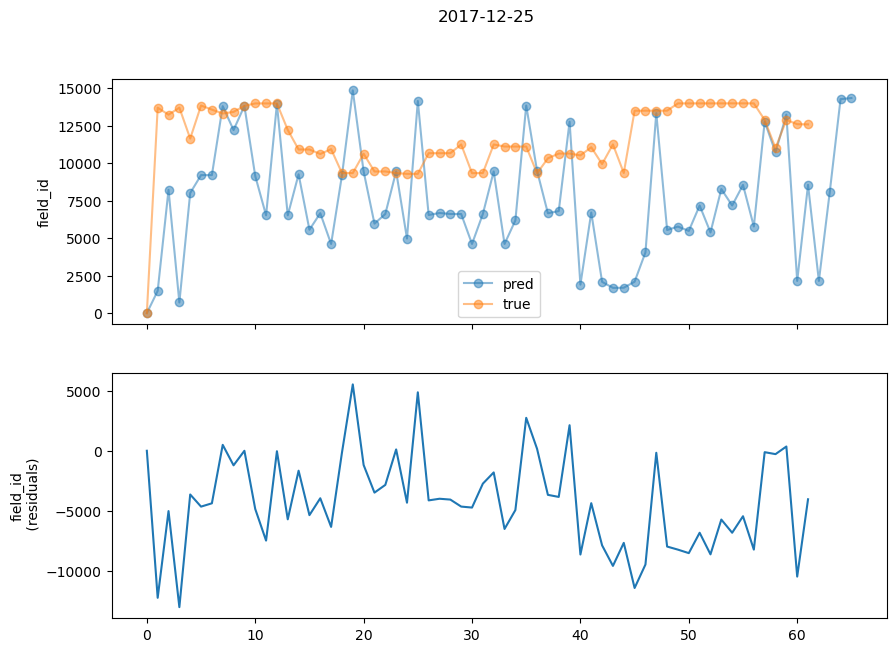

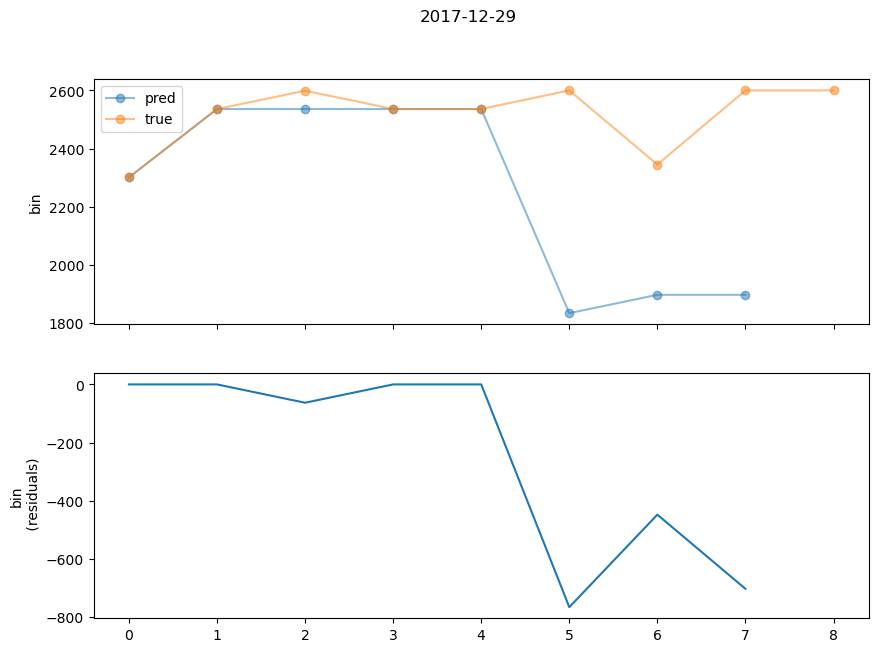

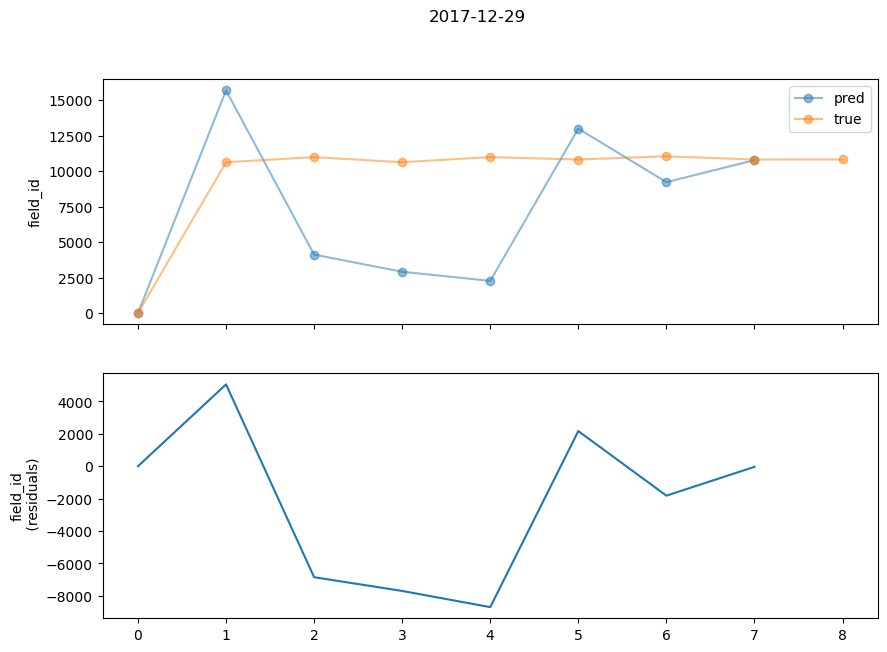

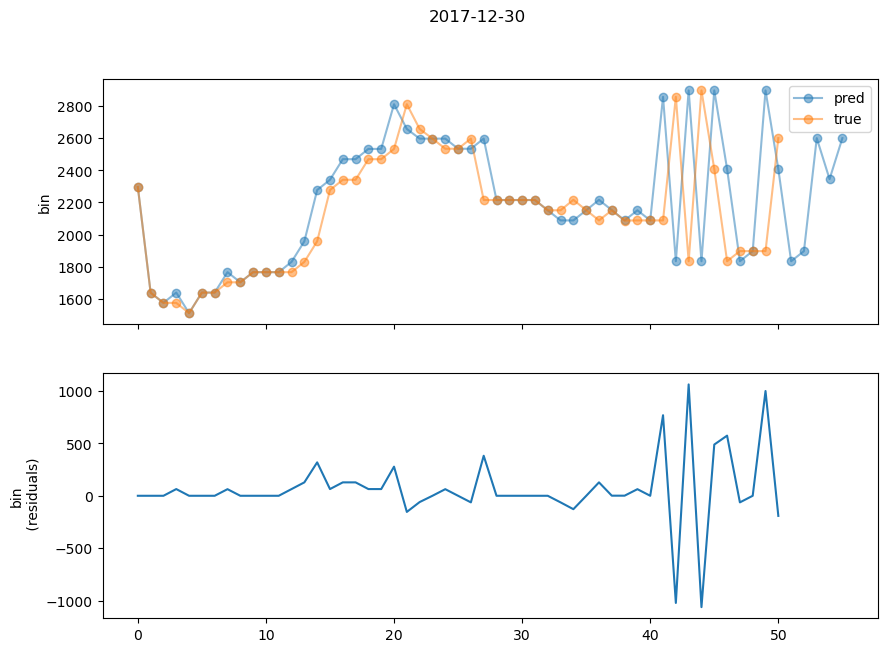

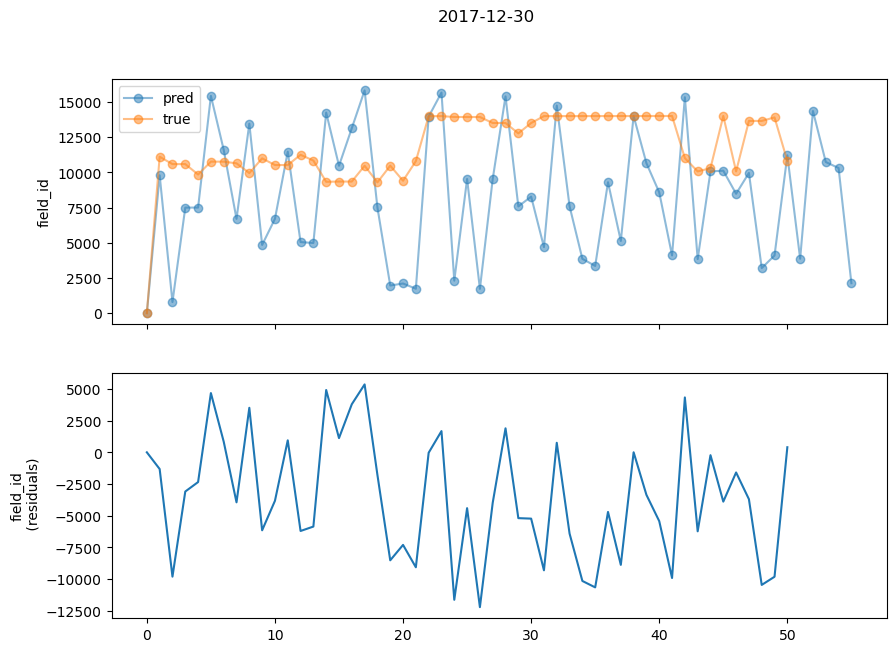

In [29]:
for night_idx, (night_name, night_group) in enumerate(test_dataset._df.groupby('night')):
    date = night_name.date()
    date_str = f"{date.year}-{date.month}-{date.day}"
    
    # Plot bins vs step
    fig_b, axs_b = plt.subplots(2, figsize=(10,7), sharex=True)
    axs_b[0].plot(eval_metrics[f'ep-{ep_num}']['bin'][f'night-{night_idx}'], marker='o', label='pred', alpha=.5)
    axs_b[0].plot(night_group['bin'].values.astype(int), marker='o', label='true', alpha=.5)
    axs_b[0].legend()
    axs_b[0].set_ylabel('bin')
    axs_b[1].plot(eval_metrics[f'ep-{ep_num}']['bin'][f'night-{night_idx}'][:len(night_group['bin'].values.astype(int))] \
                - night_group['bin'].values.astype(int)[:len(eval_metrics[f'ep-{ep_num}']['bin'][f'night-{night_idx}'])])
    axs_b[1].set_ylabel('bin' + '\n (residuals)')
    fig_b.suptitle(date_str)
    fig_b.savefig(fig_outdir + date_str + f'bin_vs_step.png')
    # plt.close()
    
    # Plot fields vs step
    fig_f, axs_f = plt.subplots(2, figsize=(10,7), sharex=True)
    axs_f[0].plot(eval_metrics[f'ep-{ep_num}']['field_id'][f'night-{night_idx}'], marker='o', label='pred', alpha=.5)
    axs_f[0].plot(night_group['field_id'].values.astype(int), marker='o', label='true', alpha=.5)
    axs_f[0].legend()
    axs_f[0].set_ylabel('field_id')
    axs_f[1].plot(eval_metrics[f'ep-{ep_num}']['field_id'][f'night-{night_idx}'][:len(night_group['field_id'].values.astype(int))] \
                - night_group['field_id'].values.astype(int)[:len(eval_metrics[f'ep-{ep_num}']['field_id'][f'night-{night_idx}'])])
    axs_f[1].set_ylabel('field_id' + '\n (residuals)')
        
    fig_f.suptitle(date_str)
    fig_f.savefig(fig_outdir + date_str + f'field_id_vs_step.png')
    # plt.close()


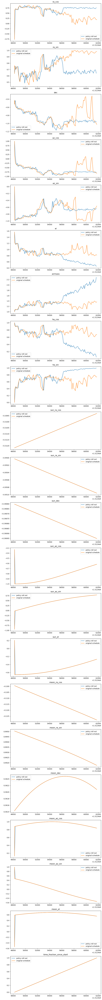

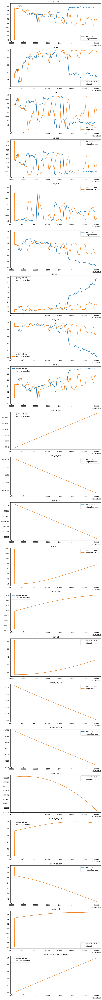

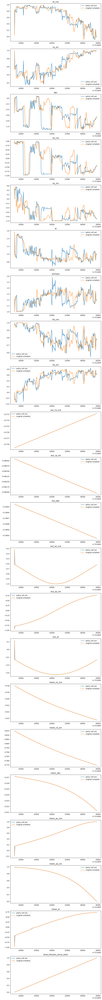

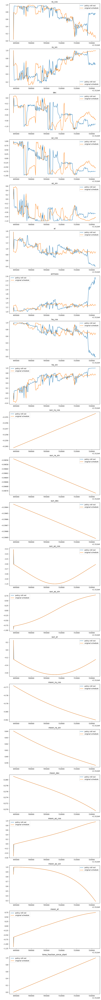

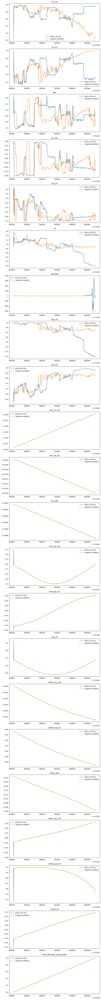

...

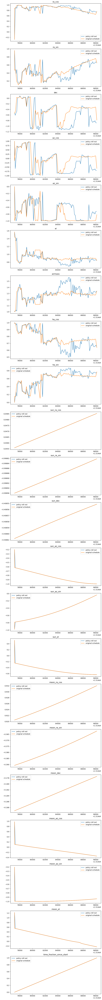

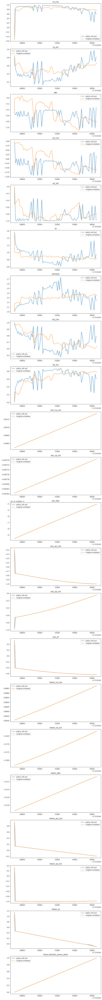

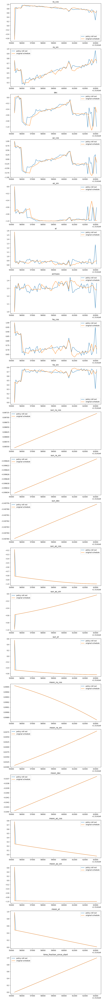

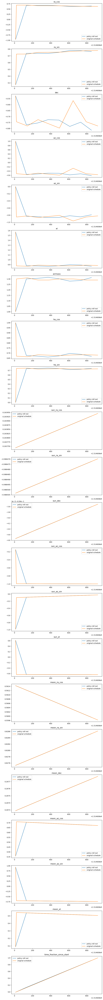

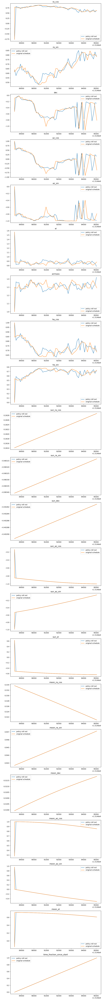

In [36]:
for night_idx, (night_name, night_group) in enumerate(test_dataset._df.groupby('night')):
    date = night_name.date()
    date_str = f"{date.year}-{date.month}-{date.day}"
    
    fig, axs = plt.subplots(len(dataset.state_feature_names), figsize=(10, len(dataset.state_feature_names)*5))
    for i, feature_row in enumerate(eval_metrics['ep-0']['observations'][f'night-{night_idx}'].T):
        feat_name = env.unwrapped.test_dataset.state_feature_names[i]
        eval_timestamps = eval_metrics['ep-0']['timestamp'][f'night-{night_idx}']
        if feat_name == 'airmass':
            eval_data = 1 / feature_row
        elif 'dec' in feat_name or 'el' in feat_name:
            eval_data = feature_row * (np.pi/2)
        else:
            eval_data = feature_row
        axs[i].plot(eval_timestamps, eval_data, label='policy roll out')
        axs[i].plot(night_group['timestamp'], night_group[feat_name].values, label='original schedule')
        axs[i].set_title(feat_name)
        axs[i].legend()


In [47]:
with open('../experiment_results/test_experiment/offline_dataset_config.pkl', 'rb') as f:
    OFFLINE_CONFIG = pickle.load(f)

In [52]:
('../data/')

{'binning_method': 'healpix',
 'nside': 16,
 'bin_space': 'radec',
 'include_default_features': True,
 'no_bin_features': True,
 'no_cyclical_norm': True,
 'no_max_norm': True,
 'no_inverse_airmass': True}

In [50]:
test_dataset.hpGrid.nside

16

In [42]:
for name, group in dataset._df.groupby('night'):
    print(len(group))

107
103
198
213
209
151
211
114
150
176
191
2
65
101
100
69
62
9
51


In [44]:
orig_field_radecs

array([[ 0.82816824, -0.98337303]])

In [45]:
eval_metrics['ep-0']['field_id'][f'night-{night_idx}'].astype(int)

array([-1])

/tmp/ipykernel_24743/1473255947.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(1, 2, figsize=(10,5), sharex=True, sharey=True)


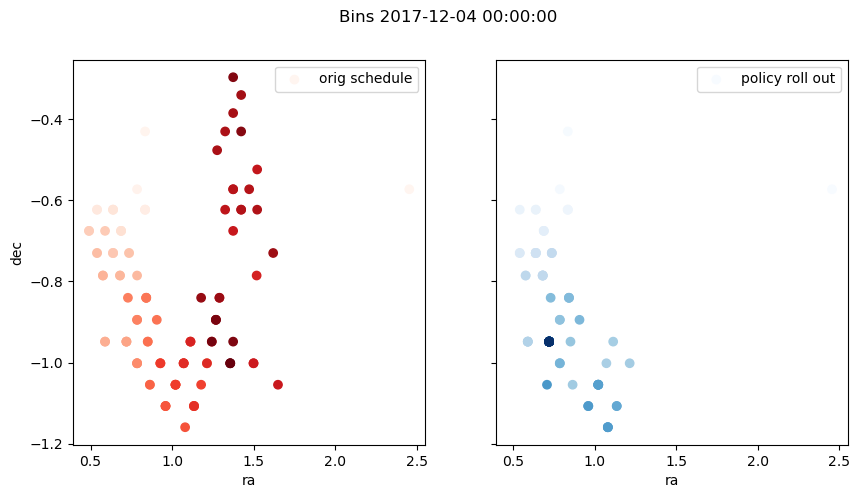

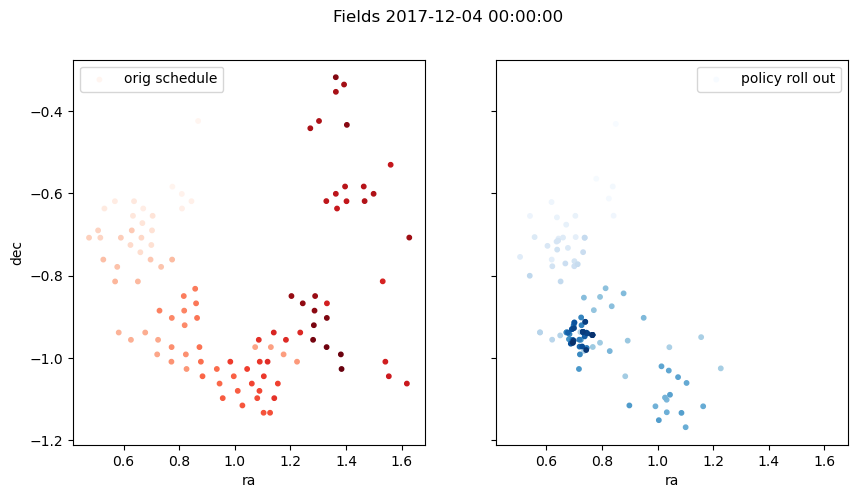

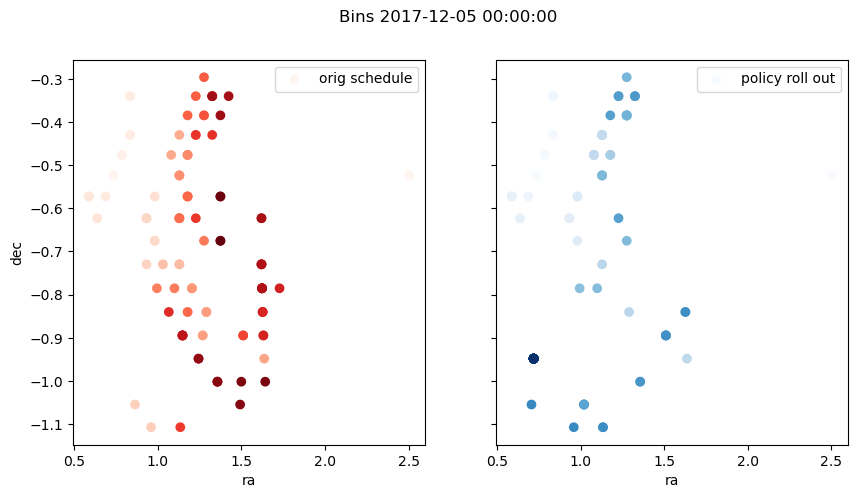

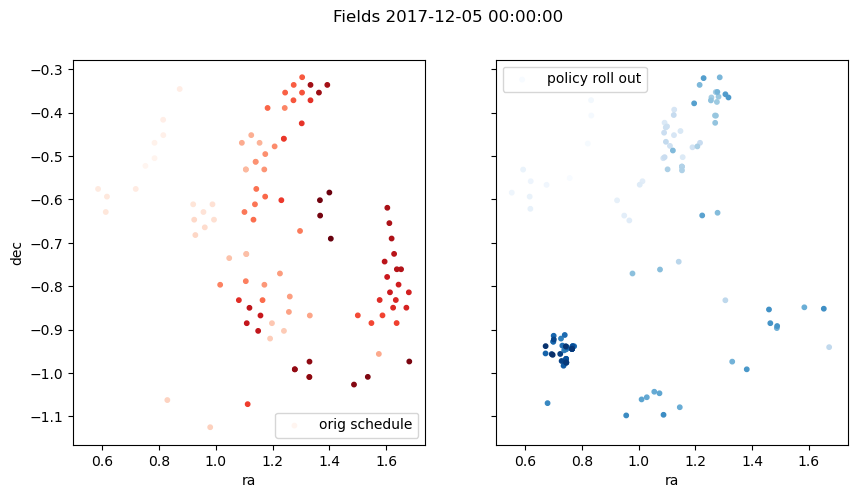

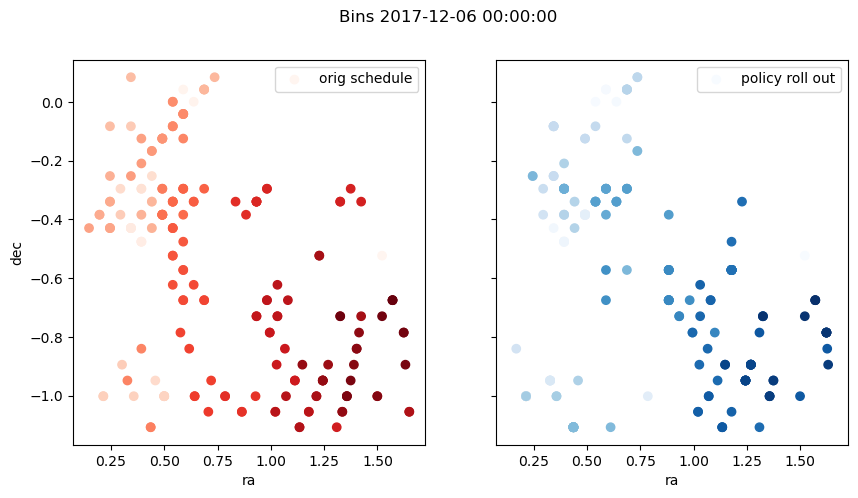

...

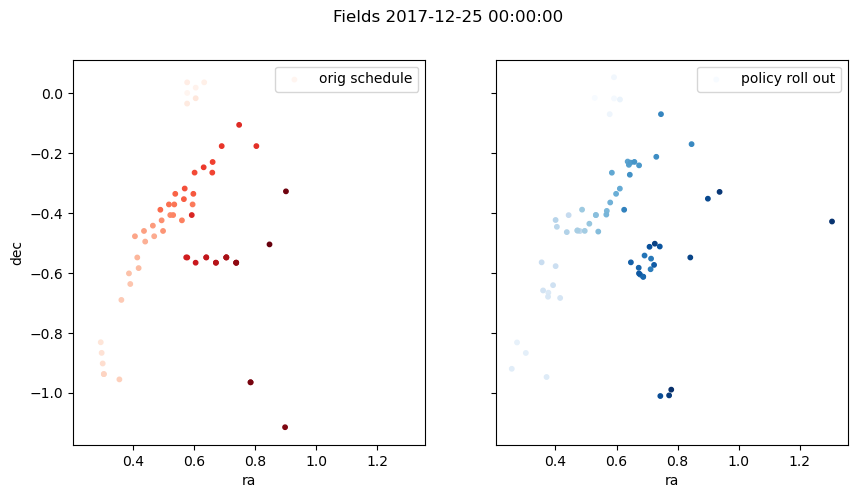

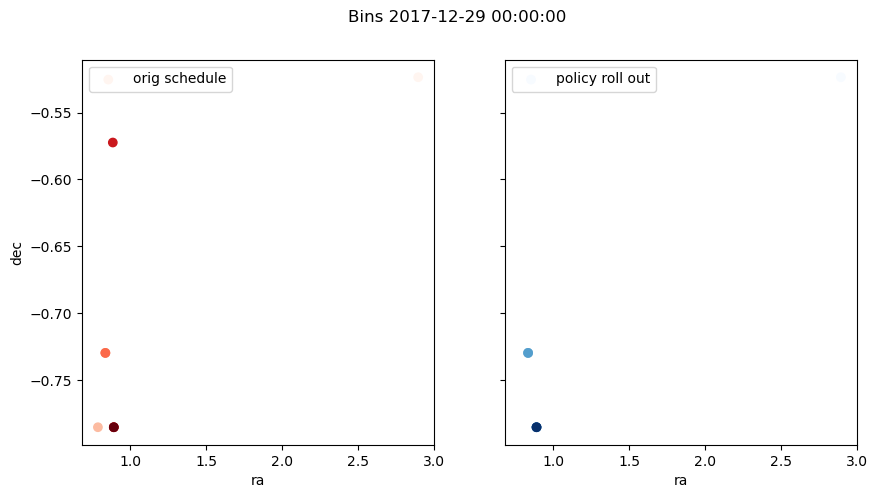

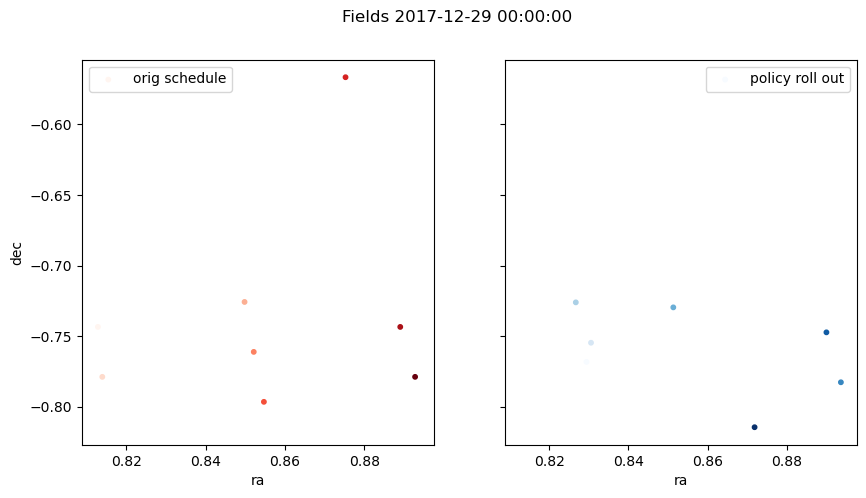

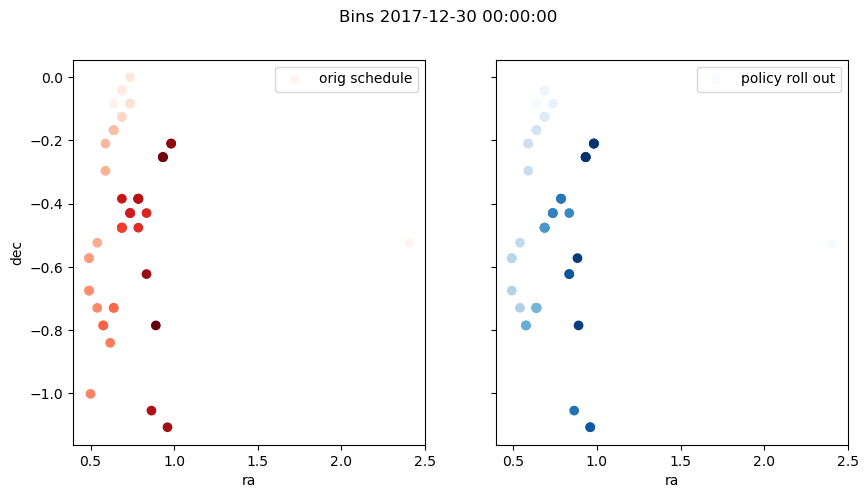

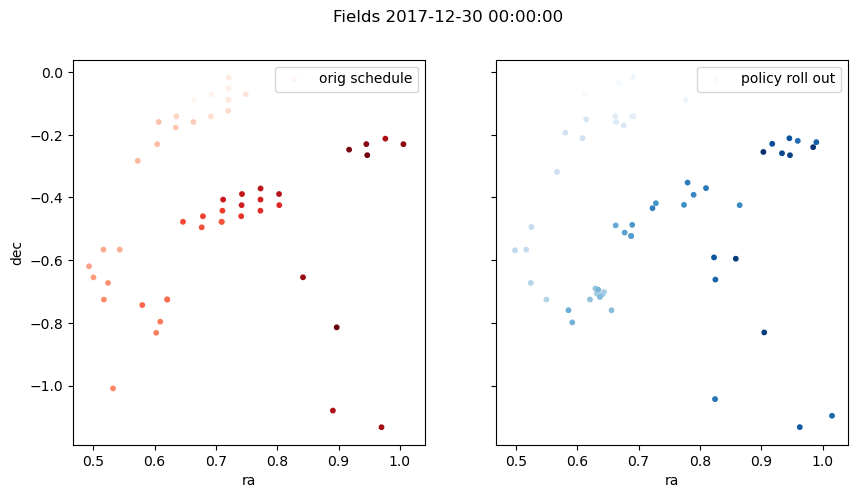

In [46]:
for night_idx, (night_name, night_group) in enumerate(test_dataset._df.groupby('night')):
    # Get radecs of bins and fields for this night
    eval_bin_radecs = np.array([env.unwrapped.test_dataset.bin2radec[bin_num] for bin_num in eval_metrics['ep-0']['bin'][f'night-{night_idx}'].astype(int) if bin_num != -1])
    orig_bin_radecs = np.array([env.unwrapped.test_dataset.bin2radec[bin_num] for bin_num in night_group['bin'].values if bin_num != -1])
    
    eval_field_radecs = np.array([env.unwrapped.test_dataset.field2radec[field_id] for field_id in eval_metrics['ep-0']['field_id'][f'night-{night_idx}'].astype(int) if field_id != -1])
    orig_field_radecs = np.array([env.unwrapped.test_dataset.field2radec[field_id] for field_id in night_group['field_id'].values.astype(int) if field_id != -1])
    if len(orig_field_radecs) != 1:
        
        # Plot each night
        fig, axs = plt.subplots(1, 2, figsize=(10,5), sharex=True, sharey=True)
        axs[0].scatter(orig_bin_radecs[:, 0], orig_bin_radecs[:, 1], label='orig schedule', cmap='Reds', c=np.arange(len(orig_bin_radecs)))
        axs[1].scatter(eval_bin_radecs[:, 0], eval_bin_radecs[:, 1], label='policy roll out', cmap='Blues', c=np.arange(len(eval_bin_radecs)))
        for ax in axs:
            ax.set_xlabel('ra')
            ax.legend()
        axs[0].set_ylabel('dec')
        fig.suptitle(f'Bins {night_name}')
        
        fig, axs = plt.subplots(1, 2, figsize=(10,5), sharex=True, sharey=True)
        axs[0].scatter(orig_field_radecs[:, 0], orig_field_radecs[:, 1], label='orig schedule', cmap='Reds', c=np.arange(len(orig_field_radecs)), s=10)
        axs[1].scatter(eval_field_radecs[:, 0], eval_field_radecs[:, 1], label='policy roll out', cmap='Blues', c=np.arange(len(eval_field_radecs)), s=10)
        for ax in axs:
            ax.set_xlabel('ra')
            ax.legend()
        axs[0].set_ylabel('dec')
        fig.suptitle(f'Fields {night_name}')

Text(0.5, 0.98, 'Fields')

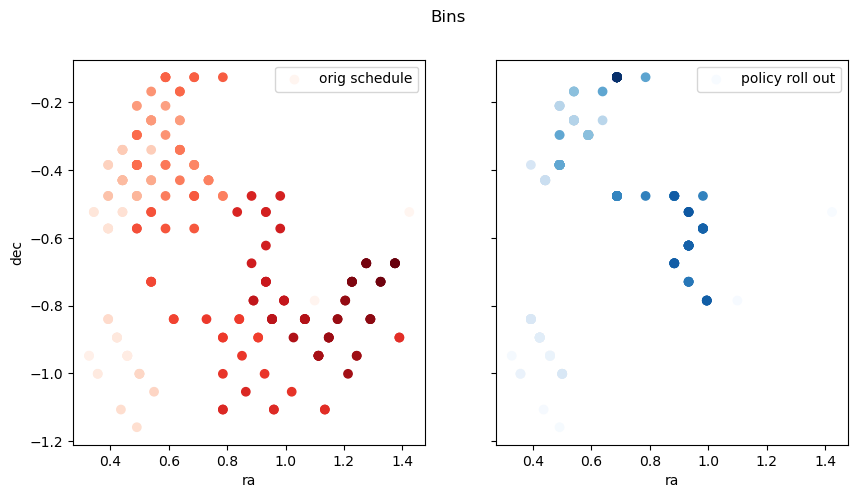

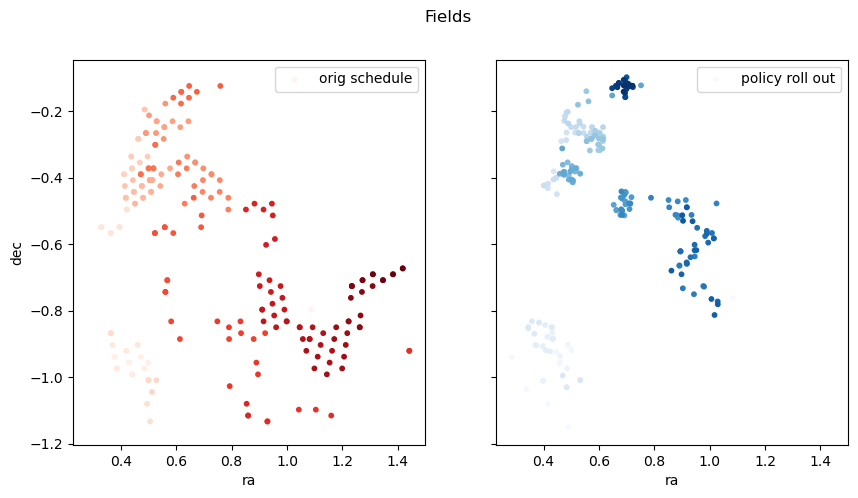

In [137]:
fig, axs = plt.subplots(1, 2, figsize=(10,5), sharex=True, sharey=True)
axs[0].scatter(orig_bin_radecs[:, 0], orig_bin_radecs[:, 1], label='orig schedule', cmap='Reds', c=np.arange(len(orig_bin_radecs)))
axs[1].scatter(eval_bin_radecs[:, 0], eval_bin_radecs[:, 1], label='policy roll out', cmap='Blues', c=np.arange(len(eval_bin_radecs)))
for ax in axs:
    ax.set_xlabel('ra')
    ax.legend()
axs[0].set_ylabel('dec')
fig.suptitle('Bins')

fig, axs = plt.subplots(1, 2, figsize=(10,5), sharex=True, sharey=True)
axs[0].scatter(orig_field_radecs[:, 0], orig_field_radecs[:, 1], label='orig schedule', cmap='Reds', c=np.arange(len(orig_field_radecs)), s=10)
axs[1].scatter(eval_field_radecs[:, 0], eval_field_radecs[:, 1], label='policy roll out', cmap='Blues', c=np.arange(len(eval_field_radecs)), s=10)
for ax in axs:
    ax.set_xlabel('ra')
    ax.legend()
axs[0].set_ylabel('dec')
fig.suptitle('Fields')

In [138]:
save_schedules = True
if save_schedules:
    _timestamps = eval_metrics['timestamps']['ep-0'] \
                  if len(eval_metrics['timestamps']['ep-0']) > len(env.unwrapped.test_dataset._df['timestamp']) \
                  else env.unwrapped.test_dataset._df['timestamp'] 
    eval_field_schedule = {
        'time': _timestamps,
        'field_id': eval_metrics['field_id']['ep-0']
    }
    
    orig_field_schedule = {
        'time': _timestamps,
        'field_id': env.unwrapped.test_dataset._df['field_id'].values
    }
    
    # bin_schedule = {
    #     'time': train_dataset_subset._df['timestamp'].values[:len(eval_metrics['timestamps']['ep-0'])],
    #     'policy_bin_id': eval_metrics['bin']['ep-0'][:len(train_dataset_subset._df['bin'].values)],
    #     'bin_id': train_dataset_subset._df['bin'].values[:len(eval_metrics['timestamps']['ep-0'])]
    # }

    
    bin_schedule = {
        'time': _timestamps,
        'policy_bin_id': eval_metrics['bin']['ep-0'].astype(np.int32),
        'bin_id': env.unwrapped.test_dataset._df['bin'].values
    }
    
    schedule_outdir = '../results/v2f-environment-testing/'
    if not os.path.exists(schedule_outdir):
        os.makedirs(schedule_outdir)
    for data, filename in zip(
        [orig_field_schedule, eval_field_schedule, bin_schedule],
        ['ood_original_schedule.csv', 'ood_eval_schedule.csv', 'ood_bin_schedule.csv']
        ):
        series_data = {key: pd.Series(value) for key, value in data.items()}
        _df = pd.DataFrame(series_data)
        if 'bin' in filename:
            _df['policy_bin_id'] = _df['policy_bin_id'].fillna(0).astype('Int64')
            _df['bin_id'] = _df['bin_id'].fillna(0).astype('Int64')
            print(_df.tail(15))
        output_filepath = '../results/v2f-environment-testing/' + filename
        with open(output_filepath, 'w') as f:
            _df.to_csv(f, index=False)

KeyError: 'timestamps'

In [89]:
# schedule file: columns `time` and `field_id`
# bin_schedule file: "time", "policy_bin_id", and "bin_id"

## Instead of trajectory, send agent batch of all states to get best next action

In [90]:
specific_years, specific_months, specific_days

([2014, 2015, 2016], [12], None)

In [52]:
test_dataset = OfflineDECamDataset(
    df, 
    binning_method=binning_method,
    nside=nside,
    bin_space=bin_space,
    specific_years=[2014],
    specific_months=[12],
    specific_days=[30],
    include_default_features=include_default_features,
    include_bin_features=include_bin_features,
    do_z_score_norm=do_z_score_norm,
    do_cyclical_norm=do_cyclical_norm,
)

/home/hurra/Projects/survey-ops/survey_ops/src/offline_dataset.py:356: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df = pd.concat([df, zenith_df], ignore_index=True)


In [53]:
with torch.no_grad():
    q_vals = agent.algorithm.policy_net(test_dataset.states.to(device))
    eval_actions = torch.argmax(q_vals, dim=1).to('cpu').detach().numpy()
    

In [54]:
# get index of the first observation for each night
first_obs_in_night_indices = []
for key, indices in test_dataset._df.groupby('night').indices.items():
    first_obs_in_night_indices.append(indices[0])

In [55]:
# Sequence of actions from target (original schedule) and policy
target_sequence = test_dataset.actions.detach().numpy()
eval_sequence = eval_actions

# # Given the action (bin) chosen in the original schedule and in the policy's schedule
# # obtain the angular separation between the two bins for all actions
# target_radec = np.array([dataset.binid2radec[bin_id] for bin_id in target_sequence])
# eval_radec = np.array([dataset.binid2radec[bin_id] for bin_id in eval_sequence])
# # target_angsep = np.array([angular_separation(pos1=target_radec[i]*units.deg, pos2=target_radec[i+1]*units.deg) for i in range(len(target_radec) - 1)]) / units.deg
# # eval_angsep = np.array([angular_separation(pos1=eval_radec[i]*units.deg, pos2=eval_radec[i+1]*units.deg) for i in range(len(target_radec) - 1)]) / units.deg
# target_eval_angsep = np.array([angular_separation(eval_radec[i]*units.deg, pos2=target_radec[i]*units.deg) for i in range(len(target_radec))]) / units.deg

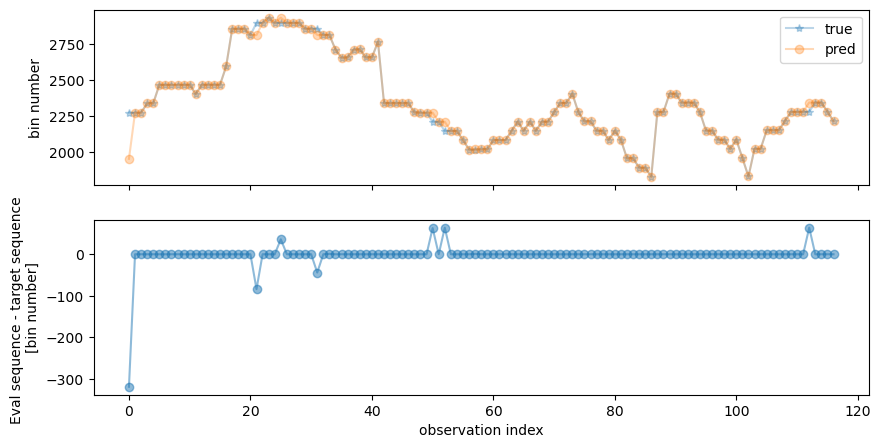

In [56]:
fig, axs = plt.subplots(2, figsize=(10,5), sharex=True)
axs[0].plot(target_sequence, marker='*', alpha=.3, label='true')
axs[0].plot(eval_sequence, marker='o', alpha=.3, label='pred')
axs[0].legend()
axs[0].set_ylabel('bin number')
axs[1].plot(eval_sequence - target_sequence, marker='o', alpha=.5)
axs[1].set_ylabel('Eval sequence - target sequence \n[bin number]')
axs[1].set_xlabel('observation index')
fig.savefig(fig_outdir + 'train_eval_and_target_bin_sequences.png')

In [147]:
eval_sequence

array([2274, 2274, 2274, 2338, 2338, 2466, 2466, 2466, 2467, 2466, 2467,
       2402, 2467, 2467, 2467, 2467, 2593, 2853, 2853, 2854, 2894, 2894,
       2894, 2894, 2894, 2894, 2894, 2894, 2894, 2854, 2855, 2811, 2811,
       2810, 2710, 2654, 2655, 2710, 2711, 2655, 2655, 2763, 2339, 2339,
       2339, 2339, 2339, 2275, 2274, 2274, 2211, 2211, 2147, 2147, 2147,
       2084, 2019, 2019, 2020, 2084, 2084, 2084, 2084, 2148, 2148, 2148,
       2212, 2148, 2212, 2212, 2276, 2340, 2340, 2404, 2276, 2213, 2213,
       2149, 2085, 2085, 2149, 2149, 1958, 1958, 1894, 1894, 1831, 2277,
       2277, 2405, 2405, 2343, 2344, 2343, 2278, 2150, 2150, 2087, 2087,
       2023, 2088, 1960, 1833, 2025, 2024, 2152, 2152, 2152, 2216, 2279,
       2279, 2280, 2280, 2280, 2344, 2280, 2216])

In [148]:
target_sequence

array([2274, 2274, 2274, 2338, 2338, 2466, 2466, 2466, 2467, 2466, 2467,
       2402, 2467, 2467, 2467, 2467, 2593, 2853, 2853, 2854, 2810, 2894,
       2894, 2930, 2894, 2894, 2894, 2894, 2894, 2854, 2855, 2855, 2811,
       2810, 2710, 2654, 2655, 2710, 2711, 2655, 2655, 2763, 2339, 2339,
       2339, 2339, 2339, 2275, 2274, 2274, 2211, 2211, 2147, 2147, 2147,
       2084, 2019, 2019, 2020, 2020, 2084, 2084, 2084, 2148, 2212, 2148,
       2212, 2148, 2212, 2212, 2276, 2340, 2340, 2404, 2276, 2213, 2213,
       2149, 2149, 2085, 2149, 2086, 1958, 1958, 1894, 1894, 1831, 2277,
       2277, 2405, 2405, 2343, 2344, 2343, 2278, 2150, 2150, 2087, 2087,
       2023, 2088, 1960, 1833, 2025, 2024, 2152, 2152, 2152, 2216, 2279,
       2279, 2280, 2280, 2344, 2344, 2280, 2216], dtype=int32)

In [149]:
test_eval_bin_radecs = np.array([test_dataset.bin2radec[bin_id] for bin_id in eval_sequence])
test_target_bin_radecs = np.array([test_dataset.bin2radec[bin_id] for bin_id in target_sequence])

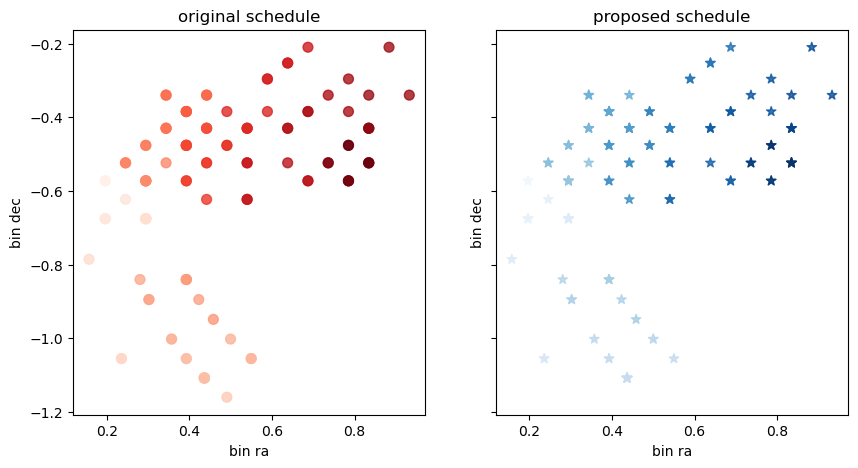

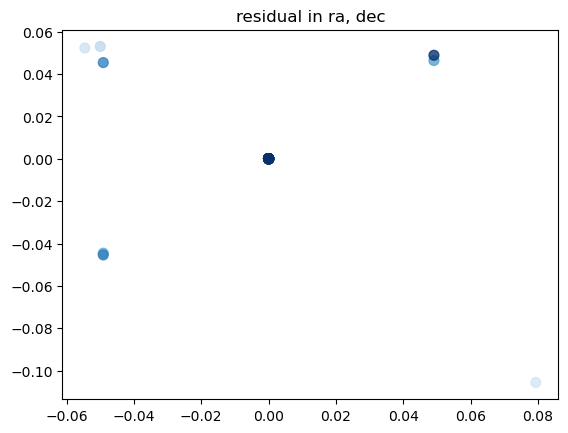

In [150]:
fig, axs = plt.subplots(1,2, figsize=(10, 5), sharex=True, sharey=True)
axs[0].scatter(test_target_bin_radecs[:, 0], test_target_bin_radecs[:, 1], cmap='Reds', s=50, alpha=.8, c=np.arange(len(test_target_bin_radecs)))
axs[1].scatter(test_eval_bin_radecs[:, 0], test_eval_bin_radecs[:, 1], cmap='Blues', alpha=.8, s=50, marker='*', c=np.arange(len(test_eval_bin_radecs)))
axs[0].set_title('original schedule')
axs[1].set_title('proposed schedule')
for ax in axs:
    ax.set_xlabel('bin ra')
    ax.set_ylabel('bin dec')
plt.show();

plt.scatter(test_eval_bin_radecs[:, 0] - test_target_bin_radecs[:, 0], test_eval_bin_radecs[:, 1] - test_target_bin_radecs[:, 1], cmap='Blues', s=50, c=np.arange(len(test_dataset)), alpha=.8)
plt.title('residual in ra, dec')
plt.show();


In [151]:
save_schedules = True
if save_schedules:
    eval_field_schedule = {
        'time': test_dataset._df['timestamp'].values[1:],
        'field_id': eval_sequence
    }
    orig_field_schedule = {
        'time': test_dataset._df['timestamp'].values[1:],
        'field_id': target_sequence
    }
    bin_schedule = {
        'time': test_dataset._df['timestamp'].values[1:],
        'policy_bin_id': eval_sequence,
        'bin_id': target_sequence
    }
    
    schedule_outdir = '../results/v2f-environment-testing/'
    if not os.path.exists(schedule_outdir):
        os.makedirs(schedule_outdir)
    for data, filename in zip(
        [orig_field_schedule, eval_field_schedule, bin_schedule],
        ['original_schedule.csv', 'eval_schedule.csv', 'bin_schedule.csv']
        ):
        _df = pd.DataFrame(data)
        output_filepath = '../results/v2f-environment-testing/' + filename
        with open(output_filepath, 'w') as f:
            _df.to_csv(f, index=False)

In [230]:
len(dataset.field2radec)

16266

# Using q-function interpolator

In [227]:
agent.algorithm.policy_net()

DQN(
  (layer1): Linear(in_features=22, out_features=1024, bias=True)
  (layer2): Linear(in_features=1024, out_features=1024, bias=True)
  (layer3): Linear(in_features=1024, out_features=3072, bias=True)
)

In [ ]:
interpolate_on_sphere(az, el, az_data=)